# Import

In [1]:
from __future__ import print_function, division
import math
from PIL import Image
import matplotlib.pyplot as plt
import numpy as np

# Soln: 2.1

width = 800
height = 531
identifying pores...
% of pores = 30.837


box size = 200  pores = 1  L = 0.354  D = -0.000
box size = 100  pores = 4  L = 0.158  D = -0.752
box size = 50  pores = 22  L = 0.079  D = -1.218
box size = 25  pores = 112  L = 0.039  D = -1.450
box size = 12  pores = 579  L = 0.019  D = -1.596
box size = 6  pores = 2764  L = 0.009  D = -1.692
box size = 3  pores = 12406  L = 0.005  D = -1.752
box size = 1  pores = 130996  L = 0.002  D = -1.818


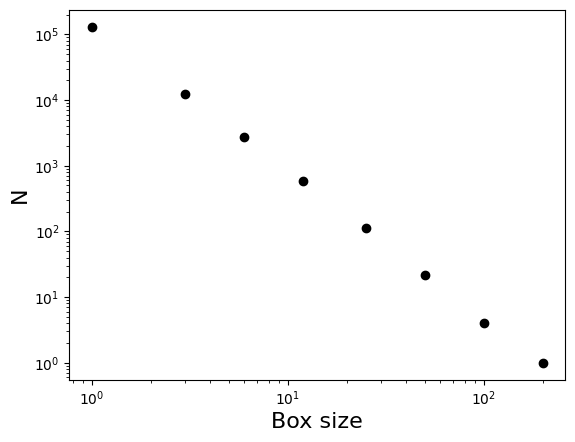

In [3]:
run PSP_boxCounting

# Soln:2.2

# Here from the question, we have these datasets.
# diameter_cylinder = 8 cm
# height_cylinder = 6 cm
# mass_cylinder_soil = 45 g
# mass_wet_sample = 445 g
# mass_dry_sample = 375 g
# density_soil = 2650 kg/m^3
# density_water = 1000 kg/m^3
# oven_drying_time = 24  hour
# oven_drying_temperature = 105 C

In [2]:
import math
from math import pi

wt_Cylinder = 45 # in g
d_Cylinder = 8 # in cm
h_Cylinder = 6 # in cm
fWsoil_w_Cylinder = 445 # in g
oDWsoil_w_Cylinder = 375 # in g
dP = 2650 # in kg/m3
dW = 1000 # in kg/m3

#Gravimetric water content (g/g)
#Formula (Mw/Ms) or (FW-ODW)/ODW

gwc = (((fWsoil_w_Cylinder-wt_Cylinder)-(oDWsoil_w_Cylinder-wt_Cylinder))/(oDWsoil_w_Cylinder-wt_Cylinder))

#Dry bulk density (g/cm3)
#Formula (Ms/Vt)

Vt = pi*(d_Cylinder/2)**2 * h_Cylinder
dB = ((oDWsoil_w_Cylinder-wt_Cylinder)/Vt)

#Volumetric water content (cm3/cm3)
#Formula (Vw/Vt) or gwc * (dB/dW)

vwc = (gwc * (dB/(dW/1000)))

#Total porosity (cm3/cm3)
#Formula (Vf/Vt) or 1 - (dB/dP)

f = (1 - (dB/(dP/1000)))

print('gravimetric_water_content (g/g) =', round(gwc, 2)) #rounds the answer to 2 decimal places
print('bulk_density (g/cm3) =', round(dB, 2))
print('volumetric_water_content (cm3/cm3) =', round(vwc, 2))
print('porosity (cm3/cm3) =', round(f, 2))

gravimetric_water_content (g/g) = 0.21
bulk_density (g/cm3) = 1.09
volumetric_water_content (cm3/cm3) = 0.23
porosity (cm3/cm3) = 0.59


# Soln: 2.3

# Soln:2.4

In [27]:
depth_Soil = 1.5
vol_soil_water_content= 0.25
depth_of_Water_m = (depth_Soil * vol_soil_water_content)*1000
print('depth_of_water_in_mm) =', depth_of_Water_m)

depth_of_water_in_mm) = 375.0


# Soln:2.5

In [35]:
msand = 0.2 
msilt = 0.6 
mclay = 0.2 

#Calculating the geometric mean diameter (dg) (in micrometer)

dg = np.exp(msand * (5.76) + msilt * (2.3) + mclay * (-1.96)) 

#Calculating the geometric standard deviation (s_g)

s_g = np.exp(math.sqrt((msand * (5.76))**2 + (msilt * (2.3))**2 + (mclay * (-1.96))**2) - np.log(dg))

print('GMD (micrometer) =', round(dg,3))
print ('GSD (micrometer) =', round(s_g, 3))

GMD (micrometer) = 8.499
GSD (micrometer) = 0.741


# Soln:2.6
# Dynamic viscosity from eqn.2.47 
# ps((4*pi*r**3)/3)g - pl((4*pi*r**3)/3)g - 6*pi*r*n*v = 0

# density_solids = ps (kg/m3)
# gravitational_A = g (m/s2)
# radius = r (m)
# density_water = pl (kg/m3)
# velocity = v (m/s)
# dynamic_viscosity = n (kg/m/s)

# ps((4*pi*r**3)/3)g - pl((4*pi*r**3)/3)g - 6*pi*r*n*v = 0
# n = (g(ps-pl)*((4*pi*r**3)/3))/6*pi*r*v 
# n = g(ps-pl)*((4*pi*r**3)/3)*(1/6*pi*r*v)
# n = (g(ps-pl)*4*r**2)/18*v
# n = LT^-2* ML^-3*L/LT^-1
# n = M/LT

# Soln: 2.7

In [3]:
def settling_timePW(particle_diameter, particle_density, liquid_densityPW, viscosityPW, g_acceleration, distance):
  
    settling_timePW = (18*viscosityPW*distance)/(g_acceleration*(particle_density-liquid_densityPW)*(particle_diameter/1000000)**2)
    return settling_timePW

#In NaHMP

def settling_timeNaHMP(particle_diameter, particle_density, liquid_densityNaHMP, viscosityNaHMP, g_acceleration, distance):

    settling_timeNaHMP = (18*viscosityNaHMP*distance)/(g_acceleration*(particle_density-liquid_densityNaHMP)*(particle_diameter/1000000)**2)
    return settling_timeNaHMP

particle_diameter = 15 # in micrometer
particle_density = 2650 # in kg/m3
liquid_densityPW = 998.23 # in kg/m3
liquid_densityNaHMP = 998.5 # in kg/m3
viscosityPW = 0.001002 # in Pa/s
viscosityNaHMP = 0.001023 # in Pa/s
g_acceleration = 9.81 # in m/s2
distance = 0.2 # in m

t1 = settling_timePW(particle_diameter, particle_density, liquid_densityPW, viscosityPW, g_acceleration, distance)
t2 = settling_timeNaHMP(particle_diameter, particle_density, liquid_densityNaHMP, viscosityNaHMP, g_acceleration, distance)

print('Settling time (s) in pure water =', round(t1, 0))
print('settling_timePW (hr) =', round(t1/3600, 2))
print('Settling time (s) in NaHMP =', round(t2, 0))
print('settling_timeNaHMP (hr) =', round(t2/3600, 2))

Settling time (s) in pure water = 989.0
settling_timePW (hr) = 0.27
Settling time (s) in NaHMP = 1010.0
settling_timeNaHMP (hr) = 0.28


In [4]:
run PSP_sedimentation

<class 'ModuleNotFoundError'>: No module named 'vpython'